In [1]:
import torch
import os
print("PyTorch has version {}".format(torch.__version__))
print(torch.version.cuda)

PyTorch has version 2.0.0+cu117
11.7


In [2]:
import math
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import random
import string
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch_geometric.transforms as T

from plotly import graph_objs as go
from sklearn.decomposition import PCA
from sklearn import metrics
from sklearn.manifold import TSNE
from sklearn.model_selection import ParameterGrid
from torch_geometric.data import Data, download_url, extract_gz
from torch_geometric.nn import GAE, GCNConv, VGAE
from torch_geometric.transforms import RandomLinkSplit
from torch_geometric.utils import train_test_split_edges, negative_sampling, degree

In [3]:
# set the seeds
torch.manual_seed(0)
random.seed(0)
np.random.seed(0)

In [ ]:
wget https://dgl-data.s3-us-west-2.amazonaws.com/dataset/DRKG/drkg.tar.gz

In [8]:
url = 'https://dgl-data.s3-us-west-2.amazonaws.com/dataset/DRKG/drkg.tar.gz'
extract_gz(download_url(url, '.'), '.')



Extracting ./drkg.tar.gz


In [20]:
!tar -xf drkg.gz

tar: drkg.gz: Cannot open: No such file or directory
tar: Error is not recoverable: exiting now


In [4]:
data_path = "/home/chirayu.tripathi/drug_repurpose/relation_glossary.tsv"
df = pd.read_csv(data_path, sep="\t")
print(df.head(), '\n')

                                Relation-name Data-source  \
0             DGIDB::ACTIVATOR::Gene:Compound       DGIDB   
1               DGIDB::AGONIST::Gene:Compound       DGIDB   
2  DGIDB::ALLOSTERIC MODULATOR::Gene:Compound       DGIDB   
3            DGIDB::ANTAGONIST::Gene:Compound       DGIDB   
4              DGIDB::ANTIBODY::Gene:Compound       DGIDB   

  Connected entity-types       Interaction-type  \
0          Compound:Gene             activation   
1          Compound:Gene                agonism   
2          Compound:Gene  allosteric modulation   
3          Compound:Gene             antagonism   
4          Compound:Gene               antibody   

                                         Description  \
0  An activator interaction is when a drug activa...   
1  An agonist interaction occurs when a drug bind...   
2  An allosteric modulator interaction occurs whe...   
3  An antagonist interaction occurs when a drug b...   
4  An antibody interaction occurs when an anti

In [5]:
df['Connected entity-types'].unique()

array(['Compound:Gene', 'Compound:Compound', 'ATC:Compound',
       'Compound:Disease', 'Gene:Gene', 'Disease:Gene', 'Gene:Tax',
       'Anatomy:Gene', 'Compound:Side Effect', 'Anatomy:Disease',
       'Disease:Symptom', 'Diisease:Disease', 'Biological Process:Gene',
       'Cellular Component:Gene', 'Gene:Molecular Function',
       'Gene:Pathway', 'Compound:Pharmacologic Class'], dtype=object)

In [6]:
df[df['Connected entity-types']=='Disease:Gene']

,Relation-name,Data-source,Connected entity-types,Interaction-type,Description,Reference for the description
24,GNBR::D::Gene:Disease,GNBR,Disease:Gene,drug targets,NaN,NaN
30,GNBR::G::Gene:Disease,GNBR,Disease:Gene,promotes progression,NaN,NaN
34,GNBR::J::Gene:Disease,GNBR,Disease:Gene,role in pathogenesis,NaN,NaN
36,GNBR::L::Gene:Disease,GNBR,Disease:Gene,improper regulation linked to disease,NaN,NaN
37,GNBR::Md::Gene:Disease,GNBR,Disease:Gene,biomarkers (diagnostic),NaN,NaN
47,GNBR::Te::Gene:Disease,GNBR,Disease:Gene,possible therapeutic effect,NaN,NaN
48,GNBR::U::Gene:Disease,GNBR,Disease:Gene,causal mutations,NaN,NaN
49,GNBR::Ud::Gene:Disease,GNBR,Disease:Gene,mutations affecting disease course,NaN,NaN
52,GNBR::X::Gene:Disease,GNBR,Disease:Gene,overexpression in disease,NaN,NaN
53,GNBR::Y::Gene:Disease,GNBR,Disease:Gene,polymorphisms alter risk,NaN,NaN


In [95]:
data_path = "/home/chirayu.tripathi/drug_repurpose/drkg.tsv"
df = pd.read_csv(data_path, sep="\t")
# print(df.head(), '\n')

In [96]:
df['bioarx::HumGenHumGen:Gene:Gene'].unique()

array(['bioarx::HumGenHumGen:Gene:Gene', 'bioarx::VirGenHumGen:Gene:Gene',
       'bioarx::DrugVirGen:Compound:Gene',
       'bioarx::DrugHumGen:Compound:Gene',
       'bioarx::Covid2_acc_host_gene::Disease:Gene',
       'bioarx::Coronavirus_ass_host_gene::Disease:Gene',
       'DGIDB::INHIBITOR::Gene:Compound',
       'DGIDB::ANTAGONIST::Gene:Compound', 'DGIDB::OTHER::Gene:Compound',
       'DGIDB::AGONIST::Gene:Compound', 'DGIDB::BINDER::Gene:Compound',
       'DGIDB::MODULATOR::Gene:Compound', 'DGIDB::BLOCKER::Gene:Compound',
       'DGIDB::CHANNEL BLOCKER::Gene:Compound',
       'DGIDB::ANTIBODY::Gene:Compound',
       'DGIDB::POSITIVE ALLOSTERIC MODULATOR::Gene:Compound',
       'DGIDB::ALLOSTERIC MODULATOR::Gene:Compound',
       'DGIDB::ACTIVATOR::Gene:Compound',
       'DGIDB::PARTIAL AGONIST::Gene:Compound',
       'DRUGBANK::x-atc::Compound:Atc',
       'DRUGBANK::ddi-interactor-in::Compound:Compound',
       'DRUGBANK::target::Compound:Gene',
       'DRUGBANK::enzyme::Compou

In [6]:
df[(df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Compound:Gene')) | (df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Gene:Compound'))]#['Gene::2157']

,Gene::2157,bioarx::HumGenHumGen:Gene:Gene,Gene::2157.1
58628,Compound::DB02573,bioarx::DrugVirGen:Compound:Gene,Gene::NVA376
58629,Compound::DB05105,bioarx::DrugVirGen:Compound:Gene,Gene::NVA193
58630,Compound::DB05105,bioarx::DrugVirGen:Compound:Gene,Gene::NVA345
58631,Compound::DB00244,bioarx::DrugVirGen:Compound:Gene,Gene::NVA298
58632,Compound::DB00684,bioarx::DrugVirGen:Compound:Gene,Gene::NVA175
...,...,...,...
4123201,Compound::DB00619,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::780
4123202,Compound::DB00619,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::84959
4123203,Compound::CHEMBL9506,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::886
4123204,Compound::DB01037,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::4129


In [7]:
df_check = df[(df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Compound:Gene')) | (df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Gene:Compound'))]

In [8]:
df_check#['Gene::2157.1']

,Gene::2157,bioarx::HumGenHumGen:Gene:Gene,Gene::2157.1
58628,Compound::DB02573,bioarx::DrugVirGen:Compound:Gene,Gene::NVA376
58629,Compound::DB05105,bioarx::DrugVirGen:Compound:Gene,Gene::NVA193
58630,Compound::DB05105,bioarx::DrugVirGen:Compound:Gene,Gene::NVA345
58631,Compound::DB00244,bioarx::DrugVirGen:Compound:Gene,Gene::NVA298
58632,Compound::DB00684,bioarx::DrugVirGen:Compound:Gene,Gene::NVA175
...,...,...,...
4123201,Compound::DB00619,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::780
4123202,Compound::DB00619,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::84959
4123203,Compound::CHEMBL9506,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::886
4123204,Compound::DB01037,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::4129


In [13]:
df_check[(df_check['Gene::2157'].str.contains('CHEMBL1723343')) | (df_check['Gene::2157.1'].str.contains('CHEMBL1723343'))]

,Gene::2157,bioarx::HumGenHumGen:Gene:Gene,Gene::2157.1
90207,Gene::2566,DGIDB::POSITIVE ALLOSTERIC MODULATOR::Gene:Com...,Compound::CHEMBL1723343
93430,Gene::2554,DGIDB::POSITIVE ALLOSTERIC MODULATOR::Gene:Com...,Compound::CHEMBL1723343
108028,Gene::2560,DGIDB::POSITIVE ALLOSTERIC MODULATOR::Gene:Com...,Compound::CHEMBL1723343


In [97]:
# df['bioarx::HumGenHumGen:Gene:Gene'].unique()
temp_graph = df[(df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Compound:Disease')) | (df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Disease:Compound')) | (df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Compound:Gene')) | (df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Gene:Compound')) | (df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Disease:Gene')) | (df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Gene:Disease'))]#'GNBR::G::Gene:Disease']df['Name']

In [17]:
# temp_graph2 = df[(df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Compound:Gene')) | (df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Gene:Compound'))]
# temp_graph3 = df[(df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Disease:Gene')) | (df['bioarx::HumGenHumGen:Gene:Gene'].str.contains('Gene:Disease'))]

In [14]:
# matching_rows = test[test['Gene::2157'].isin(test[test['Gene::2157']]['Gene::2157.1'])]

In [98]:
temp_graph

,Gene::2157,bioarx::HumGenHumGen:Gene:Gene,Gene::2157.1
58628,Compound::DB02573,bioarx::DrugVirGen:Compound:Gene,Gene::NVA376
58629,Compound::DB05105,bioarx::DrugVirGen:Compound:Gene,Gene::NVA193
58630,Compound::DB05105,bioarx::DrugVirGen:Compound:Gene,Gene::NVA345
58631,Compound::DB00244,bioarx::DrugVirGen:Compound:Gene,Gene::NVA298
58632,Compound::DB00684,bioarx::DrugVirGen:Compound:Gene,Gene::NVA175
...,...,...,...
4123201,Compound::DB00619,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::780
4123202,Compound::DB00619,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::84959
4123203,Compound::CHEMBL9506,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::886
4123204,Compound::DB01037,INTACT::PHYSICAL ASSOCIATION::Compound:Gene,Gene::4129


In [11]:
# temp_graph['Compound_id'] = temp_graph['Gene::2157'].apply(lambda x: x.split('::')[1])
# temp_graph['Disease_id'] = temp_graph['Gene::2157.1'].apply(lambda x: x.split(':')[3])

In [12]:
# temp_graph[temp_graph['Disease_id']=='D001714']

In [4]:
# sub_graph = pd.DataFrame({'Disease_id':[],'Compound_id':[]})
# sub_graph['Disease_id'] = temp_graph['Gene::2157.1']
# sub_graph['Compound_id'] = temp_graph['Gene::2157']

In [5]:
# sub_graph='nan'
# sub_graph

In [99]:
combination_graph = pd.DataFrame({'source_node':[],'destination_node':[]})
combination_graph['source_node'] = temp_graph['Gene::2157']
combination_graph['destination_node'] = temp_graph['Gene::2157.1']

In [100]:
combination_graph

,source_node,destination_node
58628,Compound::DB02573,Gene::NVA376
58629,Compound::DB05105,Gene::NVA193
58630,Compound::DB05105,Gene::NVA345
58631,Compound::DB00244,Gene::NVA298
58632,Compound::DB00684,Gene::NVA175
...,...,...
4123201,Compound::DB00619,Gene::780
4123202,Compound::DB00619,Gene::84959
4123203,Compound::CHEMBL9506,Gene::886
4123204,Compound::DB01037,Gene::4129


In [101]:
seta = list(combination_graph[(combination_graph['source_node'].str.contains('Gene'))]['source_node'].unique())
setb = list(combination_graph[(combination_graph['destination_node'].str.contains('Gene'))]['destination_node'].unique())
gene_length = len(set(seta+setb))
# combination_graph[(combination_graph['destination_node'].str.contains('Gene'))]['destination_node'].unique()

In [102]:
gene_length

31362

In [103]:
seta = list(combination_graph[(combination_graph['source_node'].str.contains('Disease'))]['source_node'].unique())
setb = list(combination_graph[(combination_graph['destination_node'].str.contains('Disease'))]['destination_node'].unique())
disease_length = len(set(seta+setb))

In [104]:
disease_length

5070

In [105]:
seta = list(combination_graph[(combination_graph['source_node'].str.contains('Compound'))]['source_node'].unique())
setb = list(combination_graph[(combination_graph['destination_node'].str.contains('Compound'))]['destination_node'].unique())
Compound_length = len(set(seta+setb))

In [106]:
Compound_length

23311

In [15]:
# len(sub_graph['Disease_id'].unique()),len(sub_graph['Compound_id'].unique())

In [109]:
def load_node_mapping(df, source_node, destination_node, category, offset=0):

#   df = pd.read_csv(datafile_path, index_col=index_col, sep="\t")
  seta = list(df[(df[source_node].str.contains(category))][source_node].unique())
  setb = list(df[(df[destination_node].str.contains(category))][destination_node].unique())
  nodes = list(set(seta+setb))
  mapping = {index_id: i + offset for i, index_id in enumerate(nodes)}
#   print(mapping)
  return mapping

def load_edge_list(df, src_col, dz_mapping, dst_col, compound_mapping,gene_mapping):

#   df = pd.read_csv(datafile_path, sep="\t")
    
#   src_nodes = [src_mapping[index] for index in df[src_col]]
#   dst_nodes = [dst_mapping[index] for index in df[dst_col]]
#   edge_index = torch.tensor([src_nodes, dst_nodes])
    src_nodes = []
    for i in df[src_col]:
        if 'Compound' in i:
            src_nodes.append(compound_mapping[i])
        elif 'Gene' in i:
            src_nodes.append(gene_mapping[i])
        elif 'Disease' in i:
            src_nodes.append(dz_mapping[i])
            
    dst_nodes = []
    for i in df[dst_col]:
        if 'Compound' in i:
            dst_nodes.append(compound_mapping[i])
        elif 'Gene' in i:
            dst_nodes.append(gene_mapping[i])
        elif 'Disease' in i:
            dst_nodes.append(dz_mapping[i])
            
    edge_index = torch.tensor([src_nodes, dst_nodes])
    return edge_index

def initialize_data(df, num_features=1):


#   dz_col, compound_col = "Disease_id", "Compound_id"
  source_node, destination_node = "source_node", "destination_node"
  dz_mapping = load_node_mapping(df, source_node, destination_node, 'Disease', offset=0)
  compound_mapping = load_node_mapping(df, source_node, destination_node,'Compound', offset=5070)
  gene_mapping = load_node_mapping(df, source_node, destination_node,'Gene', offset=5070+23311)

  # Get edge index in terms of the integer indeces assigned to the nodes.
  edge_index = load_edge_list(
      df, source_node, dz_mapping, destination_node, compound_mapping,gene_mapping)

  # Add the reverse direction (aka make it a undirected graph)
  rev_edge_index = load_edge_list(
      df, destination_node, dz_mapping, source_node,  compound_mapping,gene_mapping)


  # Construct a Data object.
  data = Data()
  data.num_nodes = len(dz_mapping) + len(compound_mapping) + len(gene_mapping)
  data.edge_index = torch.cat((edge_index, rev_edge_index), dim=1)
#   data.edge_index = edge_index
  # pretend we have uniform node features
  data.x = torch.ones((data.num_nodes, num_features))

  return data, compound_mapping, dz_mapping, gene_mapping

In [110]:
data_object, compound_mapping, dz_mapping, gene_mapping = initialize_data(combination_graph)
print(data_object)
print("Number of Compounds:", len(compound_mapping))
print("Number of Diseases:", len(dz_mapping))
print("Number of Genes:", len(gene_mapping))

Data(num_nodes=59743, edge_index=[2, 837052], x=[59743, 1])
Number of Compounds: 23311
Number of Diseases: 5070
Number of Genes: 31362


In [111]:
# compound_mapping

In [112]:
len(compound_mapping),len(dz_mapping),len(gene_mapping)

(23311, 5070, 31362)

In [113]:
# print(compound_mapping)

In [114]:
# compound_mapping
# gene_mapping
print(data_object.edge_index)

tensor([[23012, 14809, 14809,  ..., 53947, 49702, 46265],
        [53846, 38822, 43423,  ..., 19795, 20940,  7501]])


In [115]:
reverse_dz_mapping = {j: i for i,j in dz_mapping.items()}
reverse_gene_mapping = {j: i for i,j in gene_mapping.items()}
reverse_compound_mapping = {j: i for i,j in compound_mapping.items()}

degrees = degree(data_object.edge_index[0]).numpy()
sorted_degrees_i = np.argsort(-1* degrees)

print("Disease Nodes of highest degree")
top_k = 10
num_dz_nodes = 0
for i in sorted_degrees_i:
  if i < 5070:   
    node_id = reverse_dz_mapping[i]
    node_degree = degrees[i]
    print("node_index=" + str(i), "node_degree=" + str(int(node_degree)),
          node_id)
    num_dz_nodes += 1
    if num_dz_nodes >= top_k:
      break

print("\nGene Nodes of highest degree")
num_gene_nodes = 0
for i in sorted_degrees_i:
  if i >= 5070+23311:
    node_id = reverse_gene_mapping[i]
    node_degree = degrees[i]
    print("node_index=" + str(i), "node_degree=" + str(int(node_degree)), node_id)
    num_gene_nodes += 1
    if num_gene_nodes >= top_k:
      break
    
print("\nCompound Nodes of highest degree")
num_gene_nodes = 0
for i in sorted_degrees_i:
  if 5070+23311>i >= 5070:
    node_id = reverse_compound_mapping[i]
    node_degree = degrees[i]
    print("node_index=" + str(i), "node_degree=" + str(int(node_degree)), node_id)
    num_gene_nodes += 1
    if num_gene_nodes >= top_k:
      break

Disease Nodes of highest degree
node_index=1255 node_degree=8156 Disease::MESH:D009369
node_index=1905 node_degree=3428 Disease::MESH:D001943
node_index=4849 node_degree=2679 Disease::MESH:D006528
node_index=1410 node_degree=2677 Disease::MESH:D015179
node_index=4859 node_degree=2551 Disease::MESH:D011471
node_index=3261 node_degree=2463 Disease::MESH:D008545
node_index=2774 node_degree=2400 Disease::MESH:D013274
node_index=2990 node_degree=2139 Disease::MESH:D064420
node_index=4109 node_degree=2034 Disease::MESH:D010190
node_index=4535 node_degree=2007 Disease::MESH:D010051

Gene Nodes of highest degree
node_index=40762 node_degree=2483 Gene::1576
node_index=38590 node_degree=1213 Gene::1565
node_index=45346 node_degree=1166 Gene::5243
node_index=42487 node_degree=1126 Gene::3630
node_index=30086 node_degree=1093 Gene::7124
node_index=57504 node_degree=1041 Gene::1559
node_index=41510 node_degree=987 Gene::213
node_index=29426 node_degree=986 Gene::1544
node_index=47233 node_degree=91

In [116]:
NUM_FEATURES =   20

In [117]:
data_object.x = torch.ones((data_object.num_nodes, NUM_FEATURES))
print("Using dummy embeddings as initial node features.")
print("Number of features set to ", NUM_FEATURES)

Using dummy embeddings as initial node features.
Number of features set to  20


In [118]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [119]:
device

device(type='cuda')

In [120]:
transform = T.Compose([
#     T.NormalizeFeatures(),
    T.ToDevice(device),
    T.RandomLinkSplit(num_val=0.05, num_test=0.15, is_undirected=True,
                      split_labels=True, add_negative_train_samples=True),])

train_dataset, val_dataset, test_dataset = transform(data_object)
print("Train Data:\n", train_dataset)
print("Validation Data:\n", val_dataset)
print("Test Data:\n", test_dataset)

Train Data:
 Data(num_nodes=59743, edge_index=[2, 669644], x=[59743, 20], pos_edge_label=[334822], pos_edge_label_index=[2, 334822], neg_edge_label=[334822], neg_edge_label_index=[2, 334822])
Validation Data:
 Data(num_nodes=59743, edge_index=[2, 669644], x=[59743, 20], pos_edge_label=[20926], pos_edge_label_index=[2, 20926], neg_edge_label=[20926], neg_edge_label_index=[2, 20926])
Test Data:
 Data(num_nodes=59743, edge_index=[2, 711496], x=[59743, 20], pos_edge_label=[62778], pos_edge_label_index=[2, 62778], neg_edge_label=[62778], neg_edge_label_index=[2, 62778])


In [121]:
def get_mapping(df):
  
#   disease_mapping = [index_id for index_id in enumerate(df['Disease_id'].unique())]
# #   df = pd.read_csv(data_path, index_col="Gene ID", sep="\t")
#   gene_mapping = [index_id[1] for index_id in enumerate(df['Compound_id'].unique())]
  disease_mapping = [i for i in dz_mapping.keys()]
  gen_mapping = [i for i in gene_mapping.keys()]
  comp_mapping = [i for i in compound_mapping.keys()]
  mapping = disease_mapping + gen_mapping + comp_mapping
  return mapping

def visualize_tsne_embeddings(model, data, title, perplexity=30.0,
                              labeled=False, labels=[]):



  model.eval()
  x = data.x
  z = model.encode(x, data.edge_index)
  print('z done')

  ax1, ax2 = zip(*TSNE(n_components=2, learning_rate='auto', perplexity=perplexity,
                       init='random').fit_transform(z.detach().cpu().numpy()))

  fig = px.scatter(x=ax1, y=ax2, color=['r']*5070 + ['g']*23311+['b']*31362,
                   hover_data=[get_mapping(combination_graph)],
                   title=title)

  if labeled:
    for i in labels:
      fig.add_annotation(x=ax1[i], y=ax2[i],
                         text=str(i), showarrow=False)
  fig.show()

def visualize_pca_embeddings(model, data, title, labeled=False, labels=[]):

  model.eval()
  x = data.x
  z = model.encode(x, data.edge_index)

  pca = PCA(n_components=2)
  components = pca.fit_transform(z.detach().cpu().numpy())
  fig = px.scatter(components, x=0, y=1, color=['r']*5070 + ['g']*23311+['b']*31362,
                   hover_data=[get_mapping(combination_graph)], title=title)

  if labeled:
    for i in labels:
      fig.add_annotation(x=components[:,0][i], y=components[:,1][i],
                         text=str(i), showarrow=False)
  fig.show()

In [122]:
def plot_roc_curve(model, data):

  model.eval()

  x = data.x
  z = model.encode(x, data.edge_index)

  pos_preds = model.decode(z, data.pos_edge_label_index, sigmoid=True)
  neg_preds = model.decode(z, data.neg_edge_label_index, sigmoid=True)
  preds = torch.cat([pos_preds, neg_preds], dim=0)
  preds = preds.detach().cpu().numpy()

  labels = torch.cat((data.pos_edge_label, data.neg_edge_label), dim=0)
  labels = labels.detach().cpu().numpy()
  fpr, tpr, thresholds = metrics.roc_curve(labels, preds)

  # Using J-statistic: https://en.wikipedia.org/wiki/Youden%27s_J_statistic
  J = tpr - fpr
  ix = np.argmax(J)
  best_thresh = thresholds[ix]
  print('Best Threshold=%f' % (best_thresh))

  roc_auc = metrics.roc_auc_score(labels, preds)

  plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
  plt.plot([0, 1], [0, 1],'r--') # diagonal roc curve of a random classifier
  plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best=%0.2f' % best_thresh)
  plt.xlim(0, 1)
  plt.ylim(0, 1)
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  plt.legend(loc = 'lower right')
  plt.title('ROC curve for model predictions')
  plt.show()

In [123]:
def plot_training_stats(title, losses, test_auc, test_ap, train_auc, train_ap):

  fig, ax = plt.subplots()
  ax2 = ax.twinx()

  ax.set_xlabel("Training Epochs")
  ax2.set_ylabel("Performance Metric")
  ax.set_ylabel("Loss")

  plt.title(title)
  p1, = ax.plot(losses, "b-", label="training loss")
  p2, = ax2.plot(test_auc, "r-", label="test AUC")
  p3, = ax2.plot(test_ap, "g-", label="test AP")
  p4, = ax2.plot(train_auc, "o-", label="train AUC")
  p5, = ax2.plot(train_ap, "v-", label="train AP")
  plt.legend(handles=[p1, p2, p3, p4, p5])
  plt.show()

In [124]:
def get_edge_dot_products(data, model, num_dz_nodes=5070,num_com_nodes=23311):

  model.eval()
  x = data.x
  z = model.encode(x, data.edge_index).detach().cpu().numpy()
  dz_z = z[:num_dz_nodes, :]
  com_z = z[num_dz_nodes:num_dz_nodes+num_com_nodes, :]
  gene_z = z[num_dz_nodes+num_com_nodes:, :]
  print(len(dz_z),len(com_z),len(gene_z))
# (23311, 5070, 31362)


  dot_products_dz_com = np.einsum('ai,bi->ab', dz_z, com_z)
  dot_products_com_gene = np.einsum('ai,bi->ab', com_z, gene_z)
  dot_products_gene_dz = np.einsum('ai,bi->ab', gene_z, dz_z)
  return dot_products_dz_com,dot_products_com_gene,dot_products_gene_dz   


def get_ranked_edges(data_object, model, interaction, num_dz_nodes=5070,num_com_nodes=23311, num_gene_nodes = 31362):

  # Get dot products
  dz_com,com_gene,gene_dz = get_edge_dot_products(data_object, model, num_dz_nodes,num_com_nodes)
  if interaction == 'dz_com':
        return get_ranking(dz_com,num_dz_nodes)
  elif interaction == 'com_gene':
        return get_ranking(com_gene,num_com_nodes)
  else:
        return get_ranking(gene_dz,num_gene_nodes)
    
def get_ranking(edge_dot_products,nodes):

      num_possible_edges = edge_dot_products.shape[0] * edge_dot_products.shape[1]

      # Get indeces, ranked by dot product in descending order. This is a tuple (indeces[0], indeces[1]).
      ranked_edges = np.unravel_index(np.argsort(-1 * edge_dot_products, axis=None), edge_dot_products.shape)
      assert len(ranked_edges[0]) == num_possible_edges

      # Get the corresponding, ranked edge list and ranked dot products. 
      # we need to add an offset for the gene_node indeces.
      offset = np.array([np.zeros(num_possible_edges, dtype=int), nodes + np.ones(num_possible_edges, dtype=int)]).T
      ranked_edge_list = np.dstack(ranked_edges)[0] + offset
#       print(ranked_edge_list)
      assert ranked_edge_list.shape[0] == num_possible_edges

      # Get the corresponding ranked dot products
      ranked_dot_products = edge_dot_products[ranked_edges]
      assert ranked_dot_products.shape[0] == num_possible_edges

      return ranked_edge_list, ranked_dot_products

# GAE

In [125]:
HIDDEN_SIZE = 200  #@param {type: "integer"}

OUT_CHANNELS = 20  #@param {type: "integer"}

EPOCHS =   40#@param {type: "integer"}

In [126]:
class GCNEncoder(torch.nn.Module):
    def __init__(self, in_channels, hidden_size, out_channels, dropout):
        super(GCNEncoder, self).__init__()
        self.conv1 = GCNConv(in_channels, hidden_size,cached=False) # cached only for transductive learning
        self.conv2 = GCNConv(hidden_size, out_channels,cached=False) # cached only for transductive learning
        self.dropout = nn.Dropout(dropout)

    def forward(self, x, edge_index):
        x_temp1 = self.conv1(x, edge_index).relu()
        x_temp2 = self.dropout(x_temp1)
        return self.conv2(x_temp2, edge_index)

    
gae_model = GAE(GCNEncoder(NUM_FEATURES, HIDDEN_SIZE, OUT_CHANNELS, 0.5))
gae_model = gae_model.to(device)

In [127]:
gae_model

GAE(
  (encoder): GCNEncoder(
    (conv1): GCNConv(20, 200)
    (conv2): GCNConv(200, 20)
    (dropout): Dropout(p=0.5, inplace=False)
  )
  (decoder): InnerProductDecoder()
)

In [128]:
def gae_train(train_data, gae_model, optimizer):
    gae_model.train()
    optimizer.zero_grad()
    z = gae_model.encode(train_data.x, train_data.edge_index)
#     print(z[0])
#     print(train_data.pos_edge_label_index.to(device)[0])
    loss = gae_model.recon_loss(z, train_data.pos_edge_label_index.to(device))
#     print(loss)
    loss.backward(retain_graph=True)
    optimizer.step()
    return float(loss)

@torch.no_grad()
def gae_test(test_data, gae_model):
    gae_model.eval()
    z = gae_model.encode(test_data.x, test_data.edge_index)
    return gae_model.test(z, test_data.pos_edge_label_index, test_data.neg_edge_label_index)

In [36]:
# visualize_tsne_embeddings(gae_model, train_dataset, 'Untrained GAE: train set embeddings t-SNE', labeled=True, labels=[40, 190, 230, 1830, 260, 110, 280, 1967])

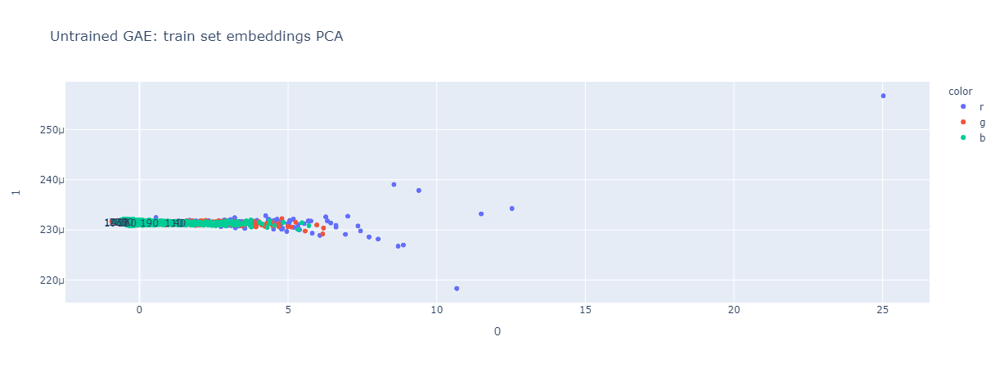

In [32]:
visualize_pca_embeddings(gae_model, train_dataset, 'Untrained GAE: train set embeddings PCA', labeled=True, labels=[40, 190, 230, 1830, 260, 110, 280, 1967])

In [46]:

# import timeit

In [129]:
# %%timeit
# %%time
losses = []
test_auc = []
test_ap = []
train_aucs = []
train_aps = []


optimizer = torch.optim.Adam(gae_model.parameters(), lr=0.01)
# def tr():
for epoch in range(1, 40):
    loss = gae_train(train_dataset, gae_model, optimizer)

    losses.append(loss)
    auc, ap = gae_test(test_dataset, gae_model)
    test_auc.append(auc)
    test_ap.append(ap)

    train_auc, train_ap = gae_test(train_dataset, gae_model)

    train_aucs.append(train_auc)
    train_aps.append(train_ap)

    print('Epoch: {:03d}, test AUC: {:.4f}, test AP: {:.4f}, train AUC: {:.4f}, train AP: {:.4f}, loss:{:.4f}'.format(epoch, auc, ap, train_auc, train_ap, loss))



Epoch: 001, test AUC: 0.9651, test AP: 0.9670, train AUC: 0.9637, train AP: 0.9655, loss:3.0690
Epoch: 002, test AUC: 0.9652, test AP: 0.9670, train AUC: 0.9638, train AP: 0.9654, loss:1.1354
Epoch: 003, test AUC: 0.9652, test AP: 0.9671, train AUC: 0.9639, train AP: 0.9657, loss:1.9171
Epoch: 004, test AUC: 0.9652, test AP: 0.9671, train AUC: 0.9639, train AP: 0.9657, loss:1.4711
Epoch: 005, test AUC: 0.9649, test AP: 0.9668, train AUC: 0.9634, train AP: 0.9653, loss:1.1041
Epoch: 006, test AUC: 0.9645, test AP: 0.9665, train AUC: 0.9628, train AP: 0.9648, loss:1.0742
Epoch: 007, test AUC: 0.9643, test AP: 0.9663, train AUC: 0.9626, train AP: 0.9646, loss:1.0698
Epoch: 008, test AUC: 0.9642, test AP: 0.9663, train AUC: 0.9625, train AP: 0.9646, loss:1.0848
Epoch: 009, test AUC: 0.9641, test AP: 0.9662, train AUC: 0.9624, train AP: 0.9645, loss:1.0876
Epoch: 010, test AUC: 0.9640, test AP: 0.9661, train AUC: 0.9622, train AP: 0.9644, loss:1.0803
Epoch: 011, test AUC: 0.9639, test AP: 0

In [44]:
%timeit -r 1 -n 1 tr()

In [64]:
# gae_model.eval()
# x = data_object.x
# z = gae_model.encode(x, data_object.edge_index).detach().cpu().numpy()
# print('z done')

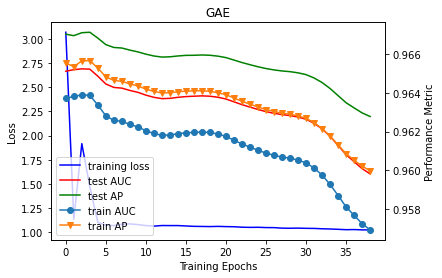

In [130]:
plot_training_stats('GAE', losses, test_auc, test_ap, train_aucs, train_aps)

Best Threshold=0.602973


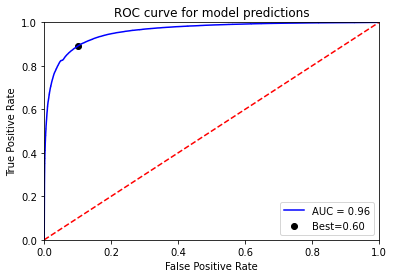

In [131]:
plot_roc_curve(gae_model, test_dataset)

In [104]:
# visualize_tsne_embeddings(
#     gae_model, train_dataset, title='Trained GAE: train set embeddings',
#     perplexity=5, labeled=True, labels=[40, 190, 230, 1830, 260, 110, 280, 1967])

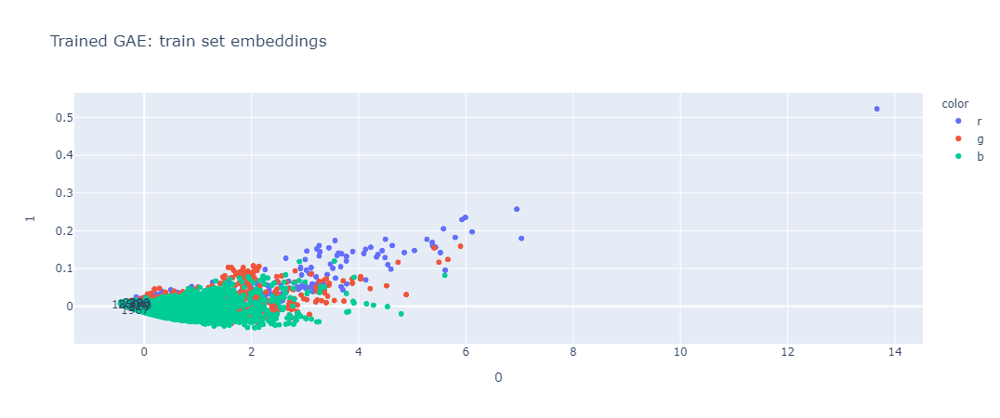

In [132]:
visualize_pca_embeddings(
    gae_model, train_dataset, title='Trained GAE: train set embeddings',
    labeled=True, labels=[40, 190, 230, 1830, 260, 110, 280, 1967])

In [133]:
data_object_to_analyze = data_object    
model_to_analyze = gae_model            

print("DataObject:\n", data_object_to_analyze)
print("\nModel:\n", model_to_analyze)

DataObject:
 Data(num_nodes=59743, edge_index=[2, 837052], x=[59743, 20])

Model:
 GAE(
  (encoder): GCNEncoder(
    (conv1): GCNConv(20, 200)
    (conv2): GCNConv(200, 20)
    (dropout): Dropout(p=0.5, inplace=False)
  )
  (decoder): InnerProductDecoder()
)


In [134]:
ranked_edge_list, ranked_dot_products = get_ranked_edges(data_object_to_analyze, model_to_analyze, interaction='dz_com')


5070 23311 31362


In [135]:
select_gene_substrings = ''
# select_disease_substrings = ['D001714']
select_disease_substrings = ["D018805"]
# (23311, 5070, 31362)

In [136]:
# Filter data frame by the selected disease terms, and get their node ids.
if select_disease_substrings:
  dz_regex = "(?i)" + "|".join(select_disease_substrings)
  query_df = combination_graph[(combination_graph['source_node'].str.contains(dz_regex)) | (combination_graph['destination_node'].str.contains(dz_regex))]
#   print(query_df)
  query_dz_nodes = [dz_mapping[dz_id] for dz_id in query_df['source_node'].drop_duplicates().tolist() if 'Disease' in dz_id]
  query_dz_nodes2 = [dz_mapping[dz_id] for dz_id in query_df['destination_node'].drop_duplicates().tolist() if 'Disease' in dz_id]
#   print(query_dz_nodes)
  query_dz_nodes = query_dz_nodes + query_dz_nodes2
#   for i in query_df.iterrows():
        
  # print("\nQueried Disease Nodes:\n", query_df['Disease Name'])
else:
  query_dz_nodes = None

# Filter data frame by the selected gene terms, and get their node ids.
if select_gene_substrings:
  gene_regex = "(?i)" + "|".join(select_gene_substrings)
  query_df = combination_graph[combination_graph['Compound_id'].notna()]
  query_df = query_df[(query_df['source_node'].str.contains(gene_regex)) | (query_df['destination_node'].str.contains(gene_regex))]
  query_gene_nodes = [gene_mapping[gene_id] for gene_id in query_df['Compound_id'].drop_duplicates().tolist()]
  # print("\nQueried Gene Nodes:\n", query_df['Gene Name'])
else:
  query_gene_nodes = None

# print(query_dz_nodes)
# Get reverse dz and gene mappings, to print out all needed info.
reverse_dz_mapping = {j: i for i,j in dz_mapping.items()}
# reverse_gene_mapping = {j: i for i,j in gene_mapping.items()}
reverse_compound_mapping = {j: i for i,j in compound_mapping.items()}

print("\nTop Predicted Edges")
top_k = 50
curr_k = 0
for dz_i, gene_i in ranked_edge_list:
  
  if query_dz_nodes and dz_i not in query_dz_nodes: #and gene_i not in reverse_compound_mapping
    continue
  if query_gene_nodes and gene_i not in query_gene_nodes:
    continue
#   print(dz_i)

  dz_id = reverse_dz_mapping[dz_i] 
  gene_id = reverse_compound_mapping[gene_i]
#   dz_description = combination_graph[combination_graph["Disease_id"] == dz_id]["Disease_id"].drop_duplicates().iloc[0]
#   gene_description = combination_graph[combination_graph["Compound_id"] == gene_id]["Compound_id"].drop_duplicates().iloc[0]
  dot_product = ranked_dot_products[curr_k]

#   print('edge=({},{}), \t dotprod={:.2f},\t descriptions=({},{},{},{})'.format(dz_i, gene_i, dot_product, dz_description, gene_description,dz_id,gene_id))
  print('edge=({},{}), \t dotprod={:.2f},\t descriptions=({},{})'.format(dz_i, gene_i, dot_product,dz_id,gene_id))

  curr_k += 1
  if curr_k > top_k:
    break


Top Predicted Edges
edge=(4478,5151), 	 dotprod=94.43,	 descriptions=(Disease::MESH:D018805,Compound::DB06404)
edge=(4478,27001), 	 dotprod=89.99,	 descriptions=(Disease::MESH:D018805,Compound::CHEMBL1201002)
edge=(4478,14546), 	 dotprod=88.20,	 descriptions=(Disease::MESH:D018805,Compound::CHEMBL1079742)
edge=(4478,15186), 	 dotprod=86.18,	 descriptions=(Disease::MESH:D018805,Compound::pubchem:135044136)
edge=(4478,26855), 	 dotprod=78.17,	 descriptions=(Disease::MESH:D018805,Compound::DB06810)
edge=(4478,20649), 	 dotprod=76.42,	 descriptions=(Disease::MESH:D018805,Compound::MESH:C418807)
edge=(4478,7700), 	 dotprod=72.64,	 descriptions=(Disease::MESH:D018805,Compound::DB08912)
edge=(4478,26440), 	 dotprod=68.75,	 descriptions=(Disease::MESH:D018805,Compound::DB14018)
edge=(4478,25911), 	 dotprod=67.14,	 descriptions=(Disease::MESH:D018805,Compound::DB07597)
edge=(4478,26508), 	 dotprod=66.30,	 descriptions=(Disease::MESH:D018805,Compound::MESH:C051263)
edge=(4478,20936), 	 dotprod=

In [70]:
# Filter data frame by the selected disease terms, and get their node ids.
if select_disease_substrings:
  dz_regex = "(?i)" + "|".join(select_disease_substrings)
  query_df = combination_graph[(combination_graph['source_node'].str.contains(dz_regex)) | (combination_graph['destination_node'].str.contains(dz_regex))]
#   print(query_df)
  query_dz_nodes = [dz_mapping[dz_id] for dz_id in query_df['source_node'].drop_duplicates().tolist() if 'Disease' in dz_id]
  query_dz_nodes2 = [dz_mapping[dz_id] for dz_id in query_df['destination_node'].drop_duplicates().tolist() if 'Disease' in dz_id]
#   print(query_dz_nodes)
  query_dz_nodes = query_dz_nodes + query_dz_nodes2
#   for i in query_df.iterrows():
        
  # print("\nQueried Disease Nodes:\n", query_df['Disease Name'])
else:
  query_dz_nodes = None

# Filter data frame by the selected gene terms, and get their node ids.
if select_gene_substrings:
  gene_regex = "(?i)" + "|".join(select_gene_substrings)
  query_df = combination_graph[combination_graph['Compound_id'].notna()]
  query_df = query_df[(query_df['source_node'].str.contains(gene_regex)) | (query_df['destination_node'].str.contains(gene_regex))]
  query_gene_nodes = [gene_mapping[gene_id] for gene_id in query_df['Compound_id'].drop_duplicates().tolist()]
  # print("\nQueried Gene Nodes:\n", query_df['Gene Name'])
else:
  query_gene_nodes = None

# print(query_dz_nodes)
# Get reverse dz and gene mappings, to print out all needed info.
reverse_dz_mapping = {j: i for i,j in dz_mapping.items()}
# reverse_gene_mapping = {j: i for i,j in gene_mapping.items()}
reverse_compound_mapping = {j: i for i,j in compound_mapping.items()}

print("\nTop Predicted Edges")
top_k = 50
curr_k = 0
for dz_i, gene_i in ranked_edge_list:
  
  if query_dz_nodes and dz_i not in query_dz_nodes: #and gene_i not in reverse_compound_mapping
    continue
  if query_gene_nodes and gene_i not in query_gene_nodes:
    continue
#   print(dz_i)

  dz_id = reverse_dz_mapping[dz_i] 
  gene_id = reverse_compound_mapping[gene_i]
#   dz_description = combination_graph[combination_graph["Disease_id"] == dz_id]["Disease_id"].drop_duplicates().iloc[0]
#   gene_description = combination_graph[combination_graph["Compound_id"] == gene_id]["Compound_id"].drop_duplicates().iloc[0]
  dot_product = ranked_dot_products[curr_k]

#   print('edge=({},{}), \t dotprod={:.2f},\t descriptions=({},{},{},{})'.format(dz_i, gene_i, dot_product, dz_description, gene_description,dz_id,gene_id))
  print('edge=({},{}), \t dotprod={:.2f},\t descriptions=({},{})'.format(dz_i, gene_i, dot_product,dz_id,gene_id))

  curr_k += 1
  if curr_k > top_k:
    break


Top Predicted Edges
edge=(3826,9421), 	 dotprod=72.34,	 descriptions=(Disease::MESH:D018805,Compound::DB00058)
edge=(3826,9164), 	 dotprod=71.77,	 descriptions=(Disease::MESH:D018805,Compound::DB02659)
edge=(3826,16945), 	 dotprod=68.86,	 descriptions=(Disease::MESH:D018805,Compound::CHEMBL10971)
edge=(3826,25524), 	 dotprod=65.42,	 descriptions=(Disease::MESH:D018805,Compound::CHEMBL1723343)
edge=(3826,10135), 	 dotprod=62.96,	 descriptions=(Disease::MESH:D018805,Compound::MESH:C075631)
edge=(3826,5127), 	 dotprod=60.29,	 descriptions=(Disease::MESH:D018805,Compound::CHEMBL99369)
edge=(3826,21334), 	 dotprod=59.54,	 descriptions=(Disease::MESH:D018805,Compound::MESH:D002109)
edge=(3826,19638), 	 dotprod=56.84,	 descriptions=(Disease::MESH:D018805,Compound::DB06762)
edge=(3826,16764), 	 dotprod=56.42,	 descriptions=(Disease::MESH:D018805,Compound::DB07943)
edge=(3826,18976), 	 dotprod=54.41,	 descriptions=(Disease::MESH:D018805,Compound::DB08833)
edge=(3826,17543), 	 dotprod=52.72,	 d

In [137]:
check = combination_graph[(combination_graph['source_node'].str.contains('D018805')) | (combination_graph['destination_node'].str.contains('D018805'))]

In [148]:
check

,source_node,destination_node
1521973,Compound::DB01330,Disease::MESH:D018805
1616729,Compound::MESH:C102006,Disease::MESH:D018805
1616861,Compound::CHEBI:15372,Disease::MESH:D018805
1616979,Compound::DB01775,Disease::MESH:D018805
1617029,Compound::DB14546,Disease::MESH:D018805
...,...,...
1787517,Gene::93759,Disease::MESH:D018805
1788296,Gene::9518,Disease::MESH:D018805
1788363,Gene::953,Disease::MESH:D018805
1788513,Gene::958,Disease::MESH:D018805


In [150]:
check[(check['source_node'].str.contains('CHEMBL1079742')) | (check['destination_node'].str.contains('CHEMBL1079742'))]

,source_node,destination_node


In [141]:
# combination_graph[(combination_graph['Compound_id'] == 'Compound::DB06404') & (combination_graph['Disease_id']=='Compound::DB06404')]